In [1]:
%%HTML
<style> code {background-color : pink !important;} </style>

### Pipeline procedure
- undistort image
- write color & gradient thresholds function ()
- combine diff thresholds to get the optimal result
- perspective transform
- For curved lines, use histogram methods to get its 2 peaks as 2 lane line from the bottom of the image, then use sliding window placed around line centers to find and follow the lines up to the top of the frame.
- Find both left and right lane curvatures based on the histogram pixels. 
- plot them on map

In [ ]:
# Calibrating the image
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt5

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        print(gray.shape)

        # Draw and display the corners
#         cv2.drawChessboardCorners(img, (9,6), corners, ret)
#         #write_name = 'corners_found'+str(idx)+'.jpg'
#         #cv2.imwrite(write_name, img)
#         cv2.imshow('img', img)
#         cv2.waitKey(500)

# cv2.destroyAllWindows()

In [ ]:
# Since we are using the same camera with same setting (pixels) on road, then save mtx and dist for undistortion
import pickle as pkl

img = cv2.imread('test_images/test1.jpg')
img_size = (img.shape[1], img.shape[0])
ret, mtx, dist, _, _ = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
dst = cv2.undistort(img, mtx, dist, None, mtx)
# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration_wide/wide_dist_pickle.p", "wb" ) )

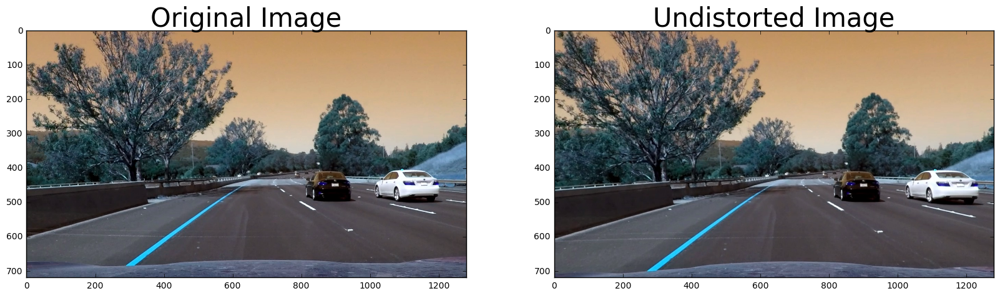

In [33]:
%matplotlib inline
test_images = glob.glob('test_images/test*.jpg')

# store all undistorted image in np array for easy access.
undist_imgs = np.zeros((1, 720, 1280, 3))

# Step through the list and search for chessboard corners
for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    img_size = (img.shape[1], img.shape[0])
    
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    if idx == 0:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=30)
    
    dst = np.expand_dims(dst, axis=0)
    undist_imgs = np.concatenate((undist_imgs, dst))
    # print(img_size)

undist_imgs = undist_imgs[1:]
undist_imgs = undist_imgs.astype(np.uint8)

In [34]:
print(undist_imgs.shape)

(6, 720, 1280, 3)


In [58]:
# cs is short for color space
def cvt_color(img, cs):
    if cs[0] == 'gray':
        color = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    elif cs[0] == 'HLS':
        color = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
        if cs[1] == 'H':
            color = color[:,:,0]
        elif cs[1] == 'L':
            color = color[:,:,1]
        else:
            color = color[:,:,2]
    return color
    
def abs_sobel_thresh(img, orient='x', cs=('gray', None), sobel_kernel=3, thresh=(0, 255)):
    color = cvt_color(img, cs)
    dx = (orient == 'x')
    dy = (orient == 'y')
    sobel = cv2.Sobel(color, cv2.CV_64F, dx, dy, ksize=sobel_kernel)
    abs_sobel = np.abs(sobel)
    scaled_sobel = np.uint8(255 * (abs_sobel/np.max(abs_sobel)))

    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel>=thresh[0]) & (scaled_sobel<=thresh[1])] = 1
    return grad_binary

def mag_thresh(img, cs=('gray', None), sobel_kernel=3, mag_thresh=(0, 255)):
    
    color = cvt_color(img, cs)
    sobelx = cv2.Sobel(color, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(color, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    mag = np.sqrt(sobelx**2 + sobely**2)
    mag = np.uint8(255*(mag/np.max(mag)))
    mag_binary = np.zeros_like(mag)
    mag_binary[(mag>=mag_thresh[0]) & (mag <=mag_thresh[1])] = 1
    return mag_binary

def dir_threshold(img, cs=('gray', None), sobel_kernel=3, thresh=(0, np.pi/2)):
    color = cvt_color(img, cs)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel)
    
    abs_sobelx = np.abs(sobelx)
    abs_sobely = np.abs(sobely)
    
    dir_gradient = np.arctan2(abs_sobely, abs_sobelx)
    
    mask = np.zeros_like(dir_gradient)
    mask[(dir_gradient > thresh[0]) & (dir_gradient < thresh[1])] = 1
    
    return mask

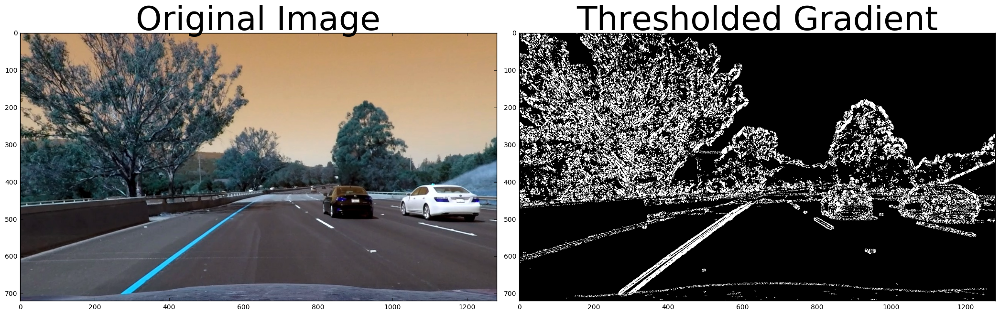

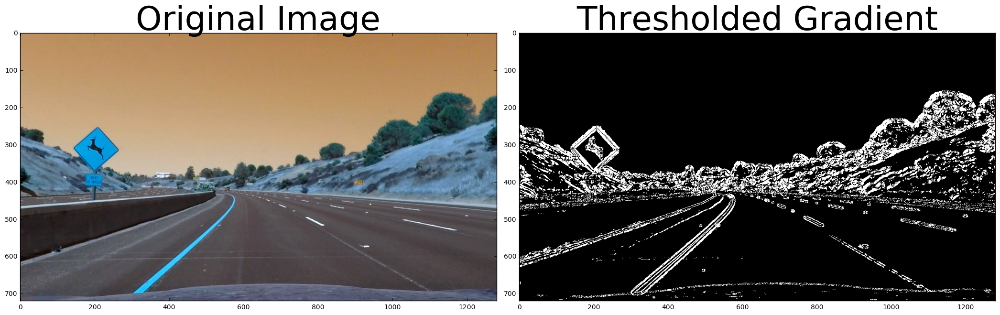

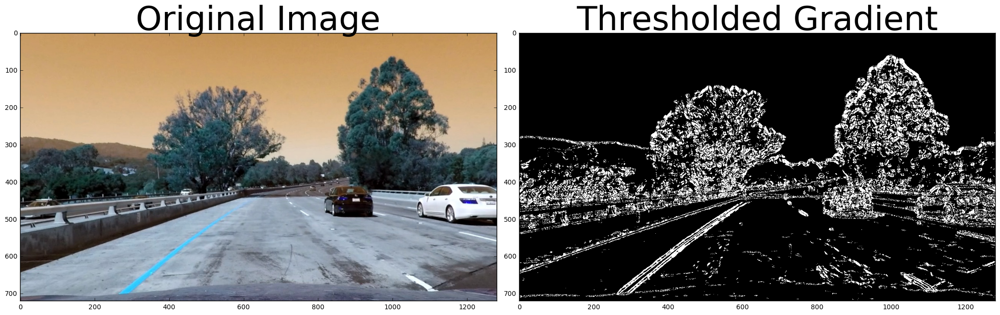

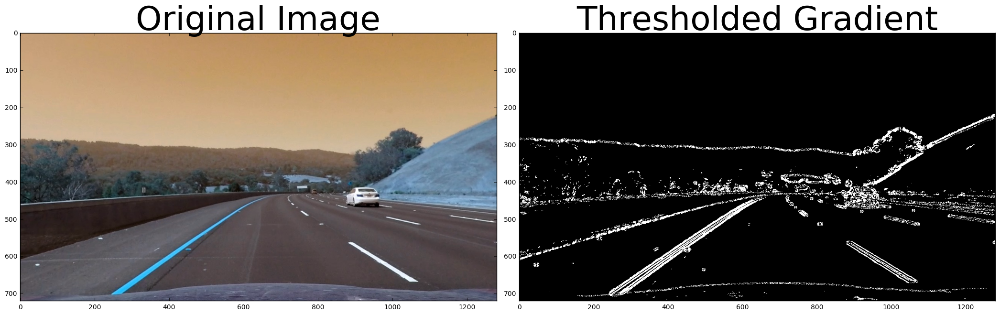

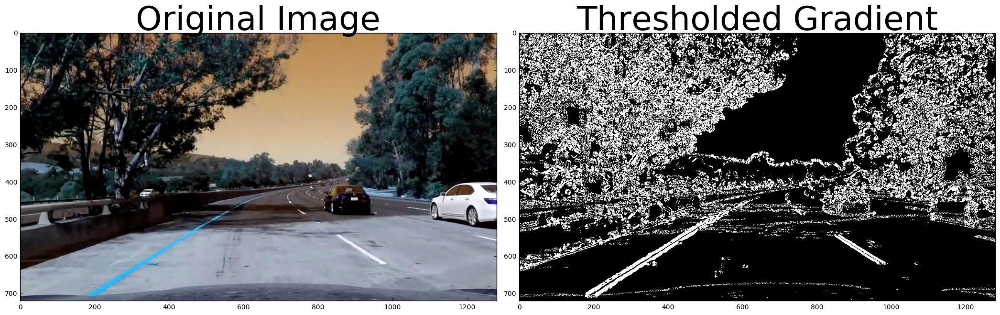

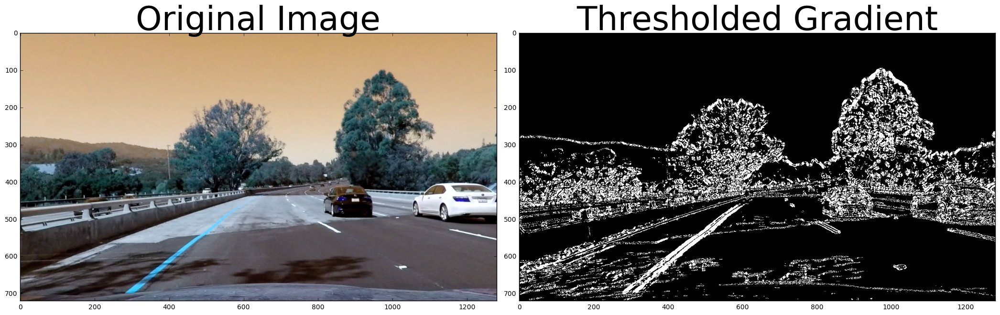

In [59]:
# try canny edge detection
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

image = undist_imgs[1]
for image in undist_imgs:
    # print(image.dtype)
    # image = cv2.imread('./test_images/test1.jpg')
    # print(image.dtype)
    # Apply each of the thresholding functions
    cs_s = ('HLS', 'S')
    gradx_s = abs_sobel_thresh(image, orient='x', cs=cs_s, sobel_kernel=ksize, thresh=(20, 100))
    grady_s = abs_sobel_thresh(image, orient='y', cs=cs_s, sobel_kernel=ksize, thresh=(20, 100))
    mag_binary_s = mag_thresh(image, cs=cs_s, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary_s = dir_threshold(image, cs=cs_s, sobel_kernel=ksize, thresh=(0.7, 1.3))
    
    cs_gray = ('gray', None)
    gradx_gray = abs_sobel_thresh(image, orient='x', cs=cs_gray, sobel_kernel=ksize, thresh=(20, 100))
    grady_gray = abs_sobel_thresh(image, orient='y', cs=cs_gray, sobel_kernel=ksize, thresh=(20, 100))
    mag_binary_gray = mag_thresh(image, cs=cs_gray, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary_gray = dir_threshold(image, cs=cs_gray, sobel_kernel=ksize, thresh=(0.7, 1.3))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx_s == 1) & (grady_s == 1)) | ((mag_binary_s == 1) & (dir_binary_s == 1)) | \
             ((gradx_gray == 1) & (grady_gray == 1)) | ((mag_binary_gray == 1) & (dir_binary_gray == 1))] = 1
    plt.figure()
    # combined[(mag_binary == 1) & (dir_binary == 1)] = 1
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.)


(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)


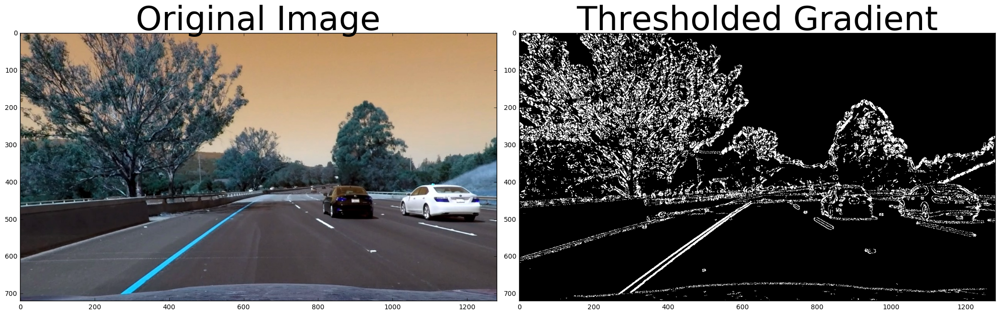

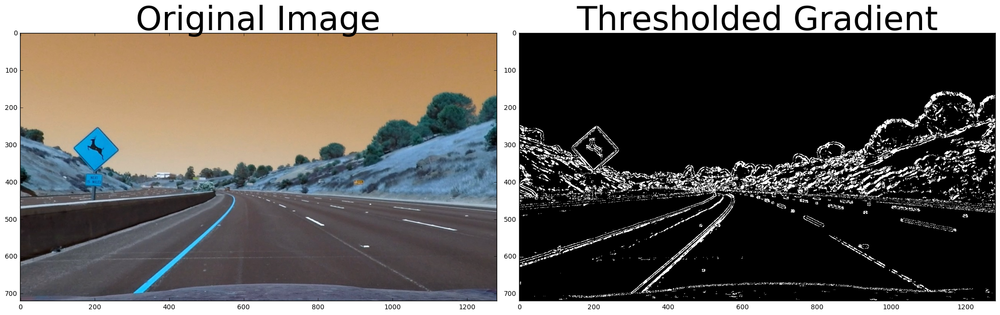

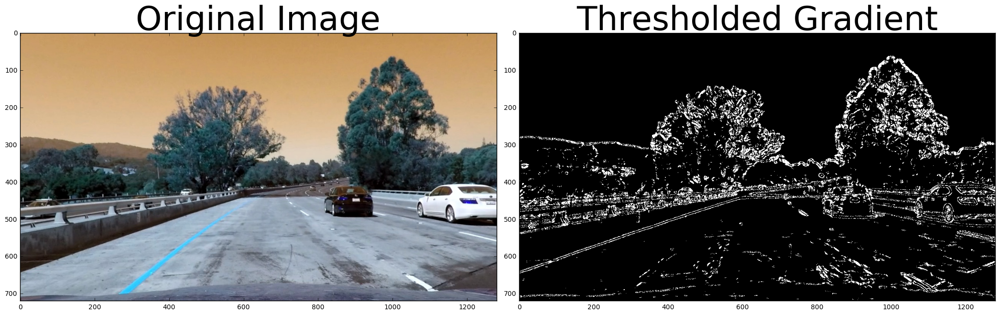

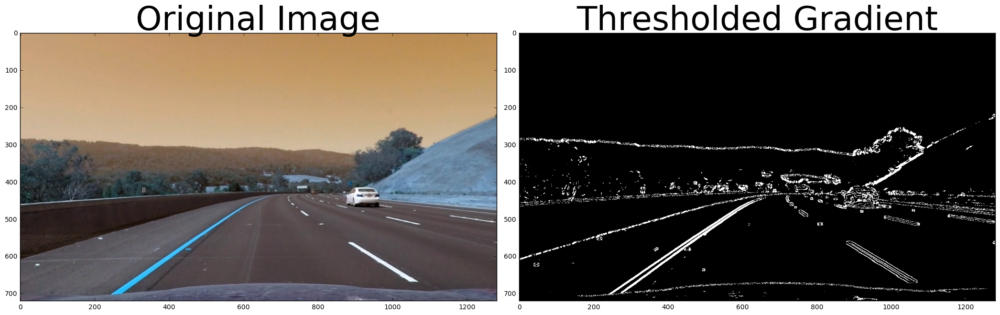

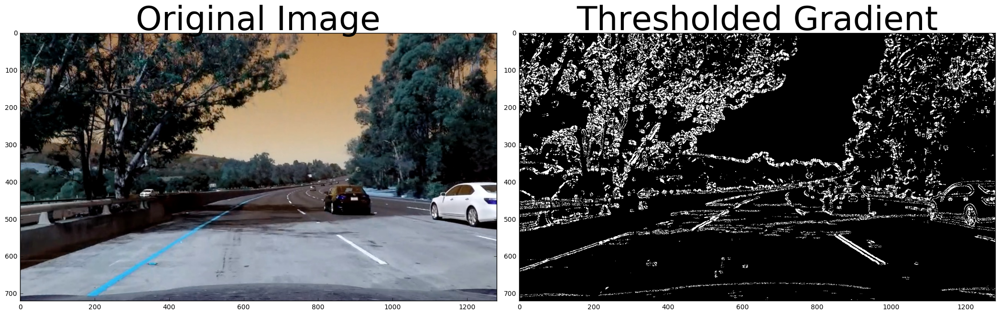

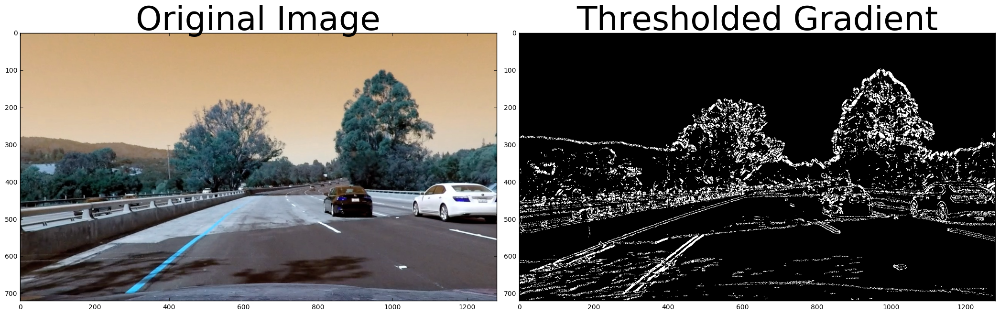

In [57]:
# try canny edge detection
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

image = undist_imgs[1]
for image in undist_imgs:
    # print(image.dtype)
    # image = cv2.imread('./test_images/test1.jpg')
    # print(image.dtype)
    # Apply each of the thresholding functions
    cs = ('HLS', 'L')
    gradx = abs_sobel_thresh(image, orient='x', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, cs=cs, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, cs=cs, sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    plt.figure()
    # combined[(mag_binary == 1) & (dir_binary == 1)] = 1
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.)


(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)


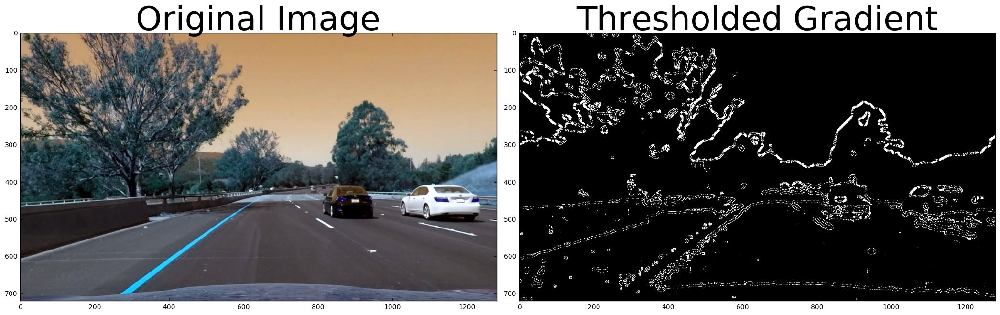

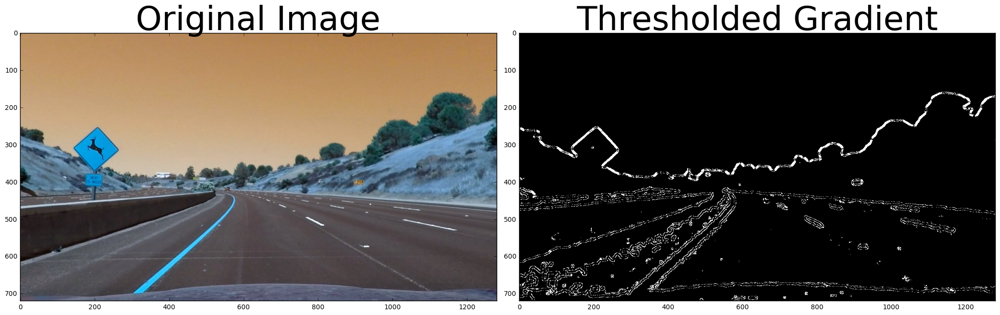

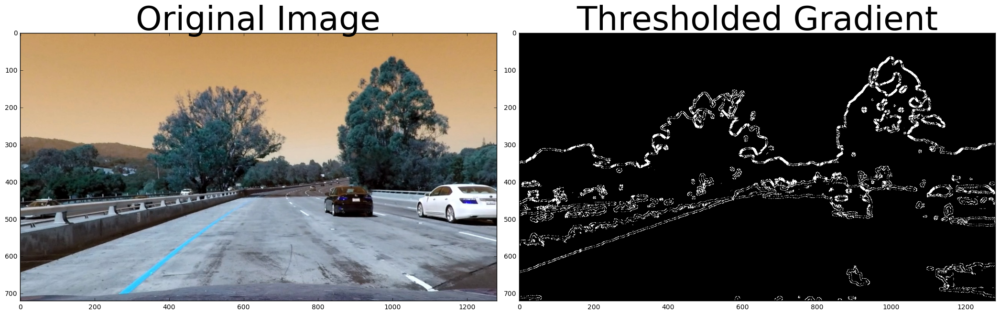

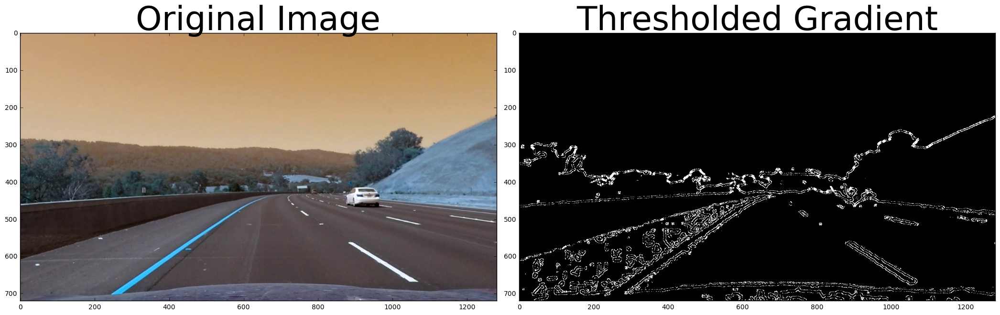

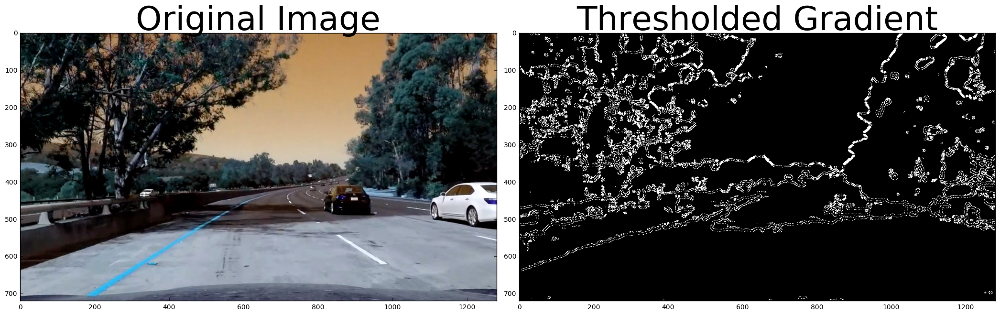

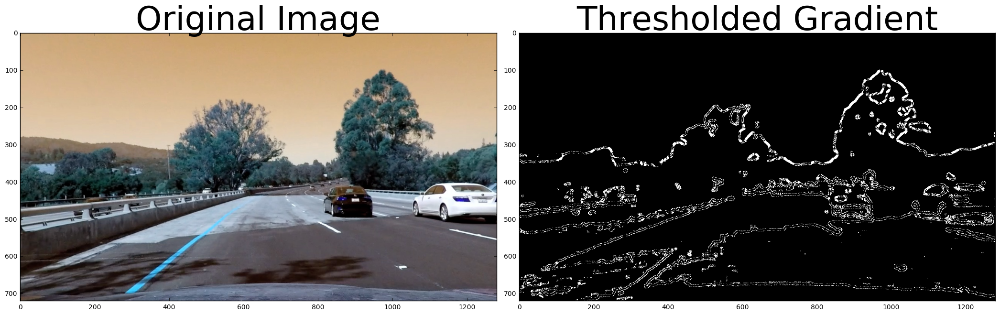

In [55]:
# try canny edge detection
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

image = undist_imgs[1]
for image in undist_imgs:
    # print(image.dtype)
    # image = cv2.imread('./test_images/test1.jpg')
    # print(image.dtype)
    # Apply each of the thresholding functions
    cs = ('HLS', 'H')
    gradx = abs_sobel_thresh(image, orient='x', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, cs=cs, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, cs=cs, sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    plt.figure()
    # combined[(mag_binary == 1) & (dir_binary == 1)] = 1
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.)


(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280, 3)
(720, 1280)


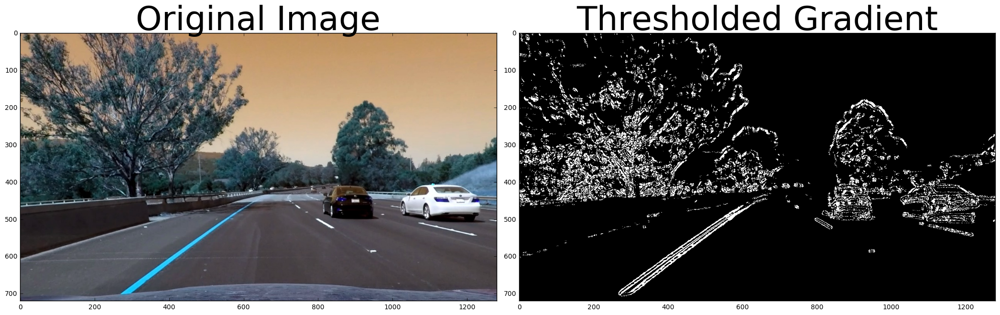

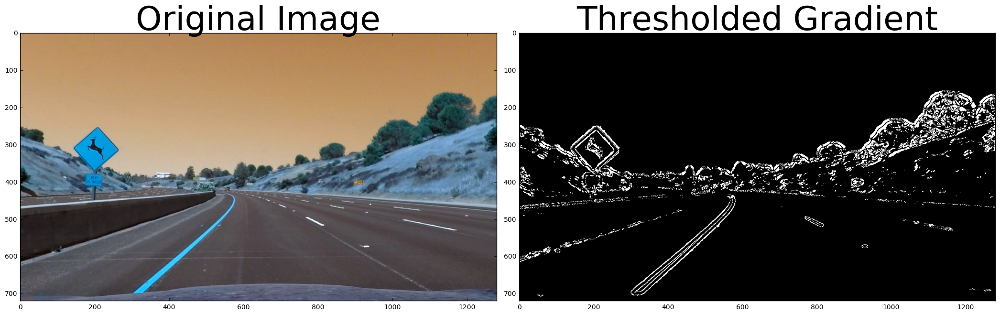

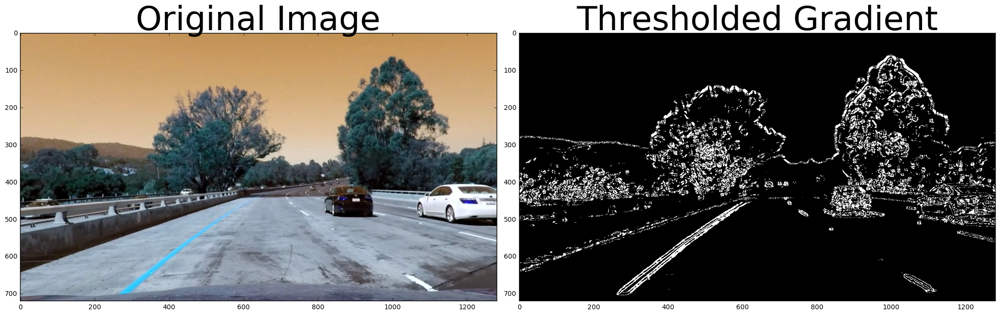

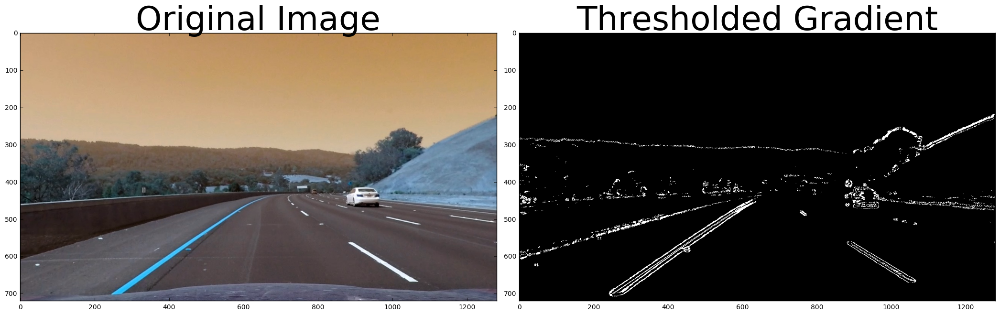

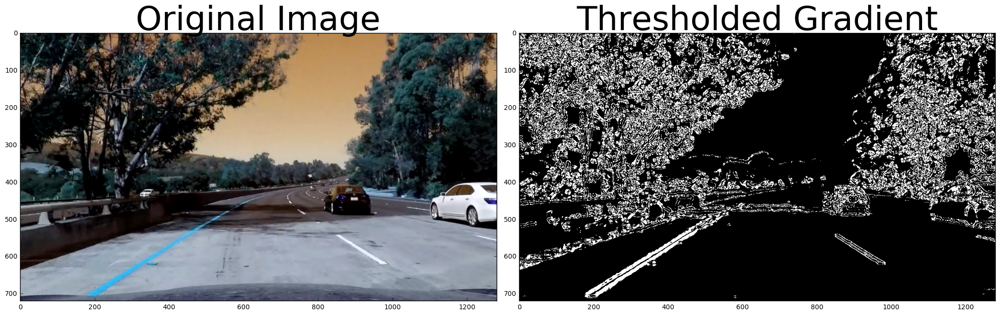

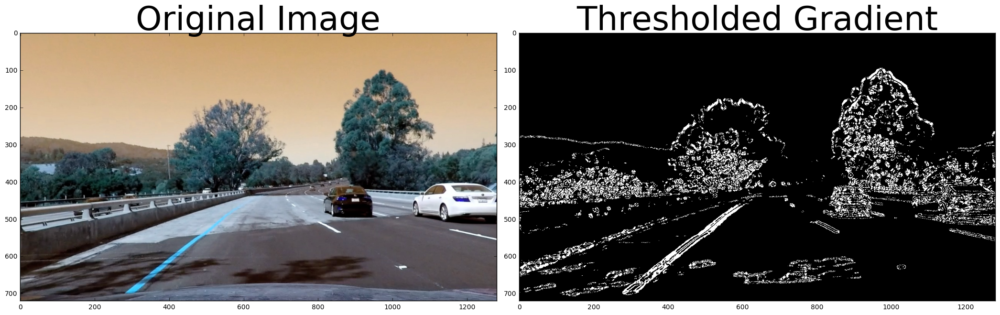

In [54]:
# try canny edge detection
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

image = undist_imgs[1]
for image in undist_imgs:
    # print(image.dtype)
    # image = cv2.imread('./test_images/test1.jpg')
    # print(image.dtype)
    # Apply each of the thresholding functions
    cs = ('HLS', 'S')
    gradx = abs_sobel_thresh(image, orient='x', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', cs=cs, sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, cs=cs, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, cs=cs, sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    plt.figure()
    # combined[(mag_binary == 1) & (dir_binary == 1)] = 1
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.)


(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)


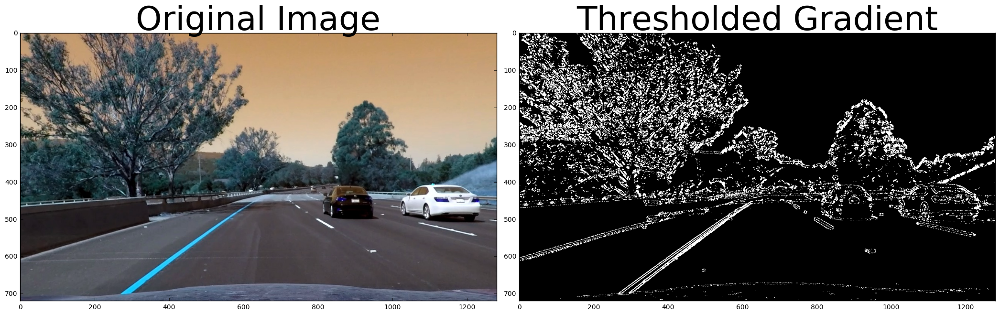

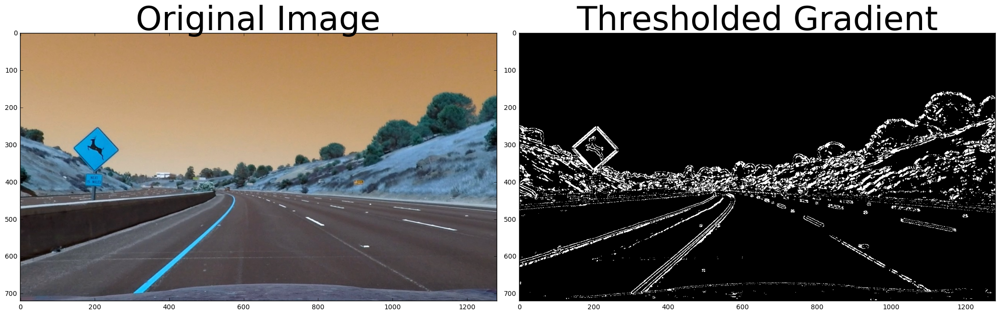

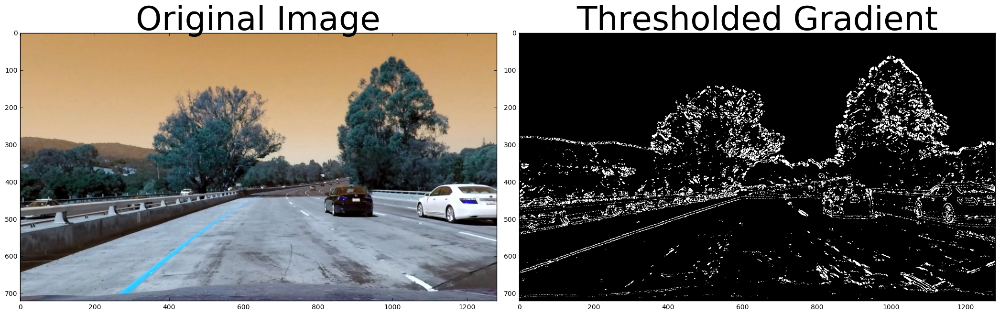

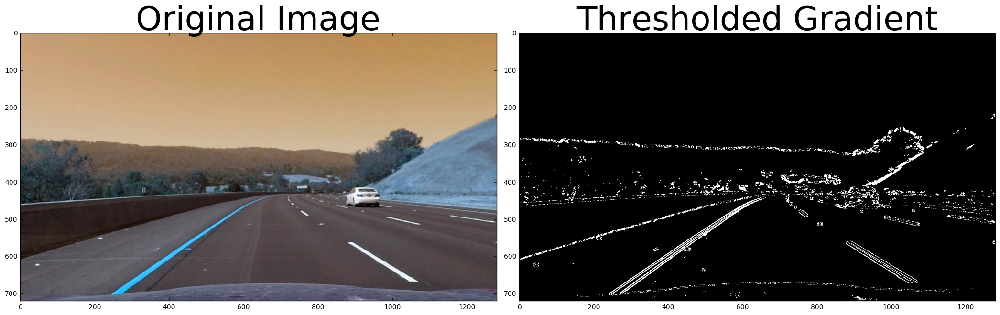

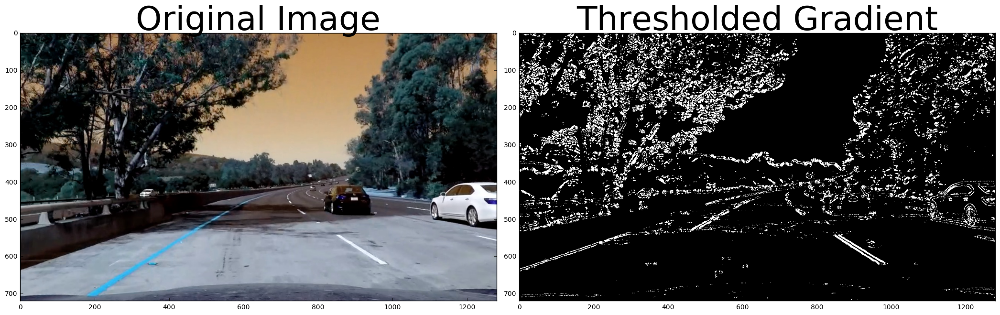

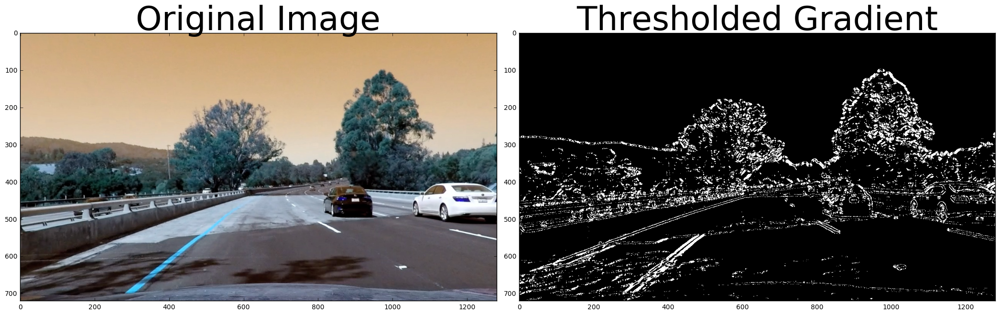

In [46]:
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

image = undist_imgs[1]
for image in undist_imgs:
    # print(image.dtype)
    # image = cv2.imread('./test_images/test1.jpg')
    # print(image.dtype)
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    plt.figure()
    # combined[(mag_binary == 1) & (dir_binary == 1)] = 1
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Thresholded Gradient', fontsize=50)
    plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.)
